<a href="https://colab.research.google.com/github/alperenozcelik/Age-Estimation/blob/main/hw1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



# CMP717: Image Processing
## Homework 1 - Edge Preserving Filters


*   Desmin Alpaslan
*   Mehmet Alperen Özçelik


*Analyze and discuss the effectiveness of edge-preserving filters in some special conditions.*

In [ ]:
# Import Libraries

# !pip install pykuwahara
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pykuwahara import kuwahara
import os

In [ ]:
folder_path = '/content/drive/MyDrive/CMP717/HW1/Images/'

In [ ]:
# Function to add Gaussian noise to an image with a given probability
def add_gaussian_noise(image, probability):
    row, col = image.shape
    # Gaussian noise distributed in mean=128 and variance=10
    noise = np.random.normal(128, 10, (row, col))
    noisy_image = np.where(np.random.rand(row, col) < probability, image + noise, image)
    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)

    return noisy_image


# Function to add uniform noise to an image with a given probability
def add_uniform_noise(image, probability):
    row, col = image.shape
    # Uniform noise distributed between 0 and 255
    noise = np.random.uniform(0, 255, (row, col))
    noisy_image = np.where(np.random.rand(row, col) < probability, image + noise, image)
    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)

    return noisy_image


# Function to plot results
def plot_results(image, noisy_image, median_5x5, bilateral_5x5, kuwahara_5, median_15x15, bilateral_15x15, kuwahara_15, detail, prob, noise_type):

  plt.figure(figsize=(20, 6))

  plt.subplot(2, 4, 1)
  plt.imshow(image, cmap='gray')
  plt.title(detail + ' Detail Image')
  plt.axis('off')

  plt.subplot(2, 4, 2)
  plt.imshow(noisy_image, cmap='gray')
  plt.title(noise_type + ' Noise p=' + str(prob))
  plt.axis('off')

  plt.subplot(2, 4, 3)
  plt.imshow(median_5x5, cmap='gray')
  plt.title('Median Filter 5x5')
  plt.axis('off')

  plt.subplot(2, 4, 4)
  plt.imshow(bilateral_5x5, cmap='gray')
  plt.title('Bilateral Filter 5x5')
  plt.axis('off')

  plt.subplot(2, 4, 5)
  plt.imshow(kuwahara_5, cmap='gray')
  plt.title('Kuwahara Filter r=5')
  plt.axis('off')

  plt.subplot(2, 4, 6)
  plt.imshow(median_15x15, cmap='gray')
  plt.title('Median Filter 15x15')
  plt.axis('off')

  plt.subplot(2, 4, 7)
  plt.imshow(bilateral_15x15, cmap='gray')
  plt.title('Bilateral Filter 15x15')
  plt.axis('off')

  plt.subplot(2, 4, 8)
  plt.imshow(kuwahara_15, cmap='gray')
  plt.title('Kuwahara Filter r=15')
  plt.axis('off')

  plt.show()


# Execute 3 different filters to images and plot results
def execute_filters(noise_type, probability, images):

  details = ['High', 'Low', 'Mid'] # For plot headers

  cnt = 0
  for image in images:

    if noise_type == 'Gaussian':
      # Apply Gaussian noise
      noisy_image = add_gaussian_noise(image, probability)

    else:
      # Apply Uniform noise
      noisy_image = add_uniform_noise(image, probability)

    # Apply Median Filter (5x5)
    median_5x5 = cv2.medianBlur(noisy_image, 5)
    # Apply Bilateral Filter (5x5)
    bilateral_5x5 = cv2.bilateralFilter(noisy_image, 5, 75, 75)
    # Apply Kuwahara Filter (r=5)
    kuwahara_5 = kuwahara(noisy_image, method='gaussian', radius=5)
    # Apply Median Filter (15x15)
    median_15x15 = cv2.medianBlur(noisy_image, 15)
    # Apply Bilateral Filter (15x15)
    bilateral_15x15 = cv2.bilateralFilter(noisy_image, 15, 75, 75)
    # Apply Kuwahara Filter (r=15)
    kuwahara_15 = kuwahara(noisy_image, method='gaussian', radius=15)

    # Plot images side by side
    plot_results(image, noisy_image, median_5x5, bilateral_5x5, kuwahara_5, median_15x15, bilateral_15x15, kuwahara_15, details[cnt], probability, noise_type)

    cnt += 1

# **Medical Images**

Read grayscale medical images


In [ ]:
# Get the list of files in the folder
file_list = os.listdir(folder_path)
file_list = sorted(file_list)

# Create a list to store medical grayscale images
medical_test_images = []

for file in file_list:
  if file.startswith("m_"):
      file_path = os.path.join(folder_path, file)
      # Read the grayscale image
      image = cv2.imread(file_path, cv2.IMREAD_GRAYSCALE)
      # Append the grayscale image to the list
      medical_test_images.append(image)

## **Gaussian Noise**

### **Probability: 0.1**

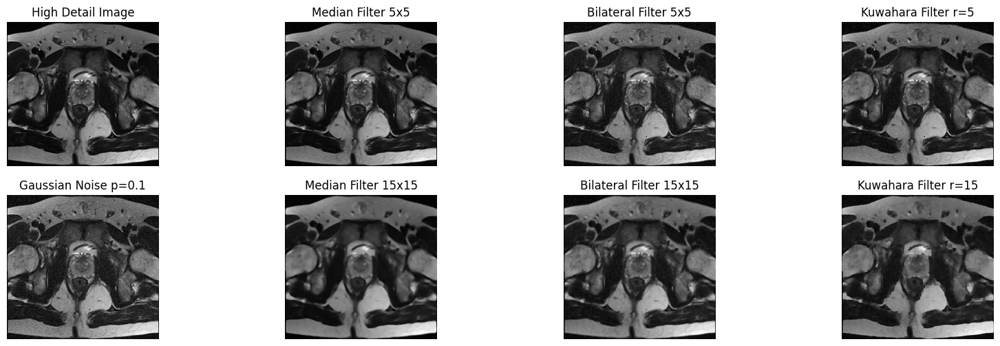

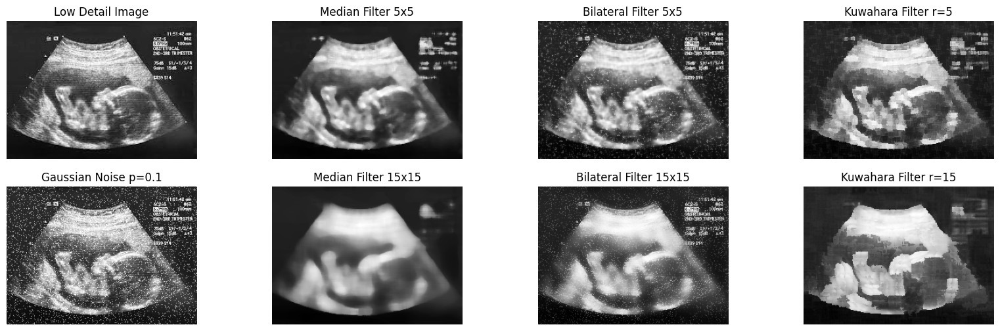

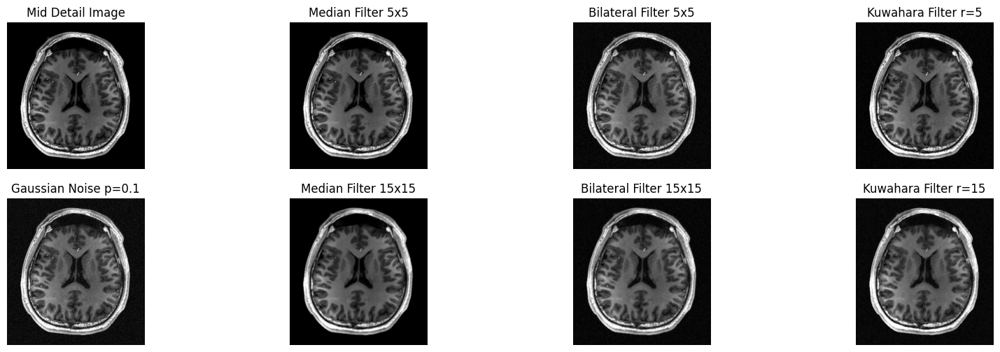

In [ ]:
execute_filters('Gaussian', 0.1, medical_test_images)

### **Probability: 0.5**

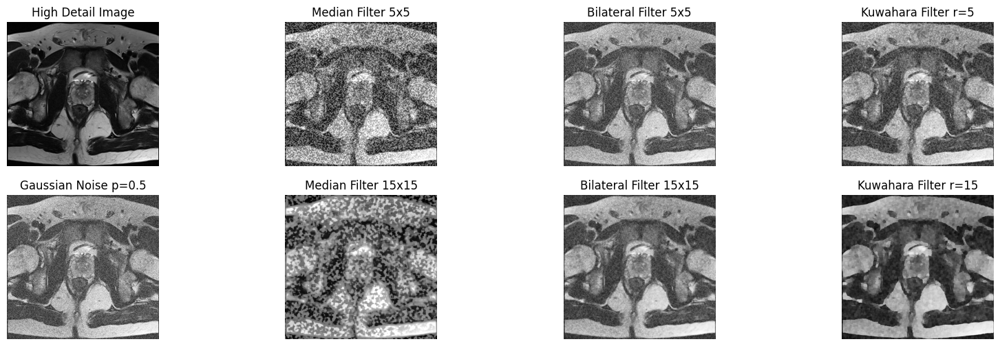

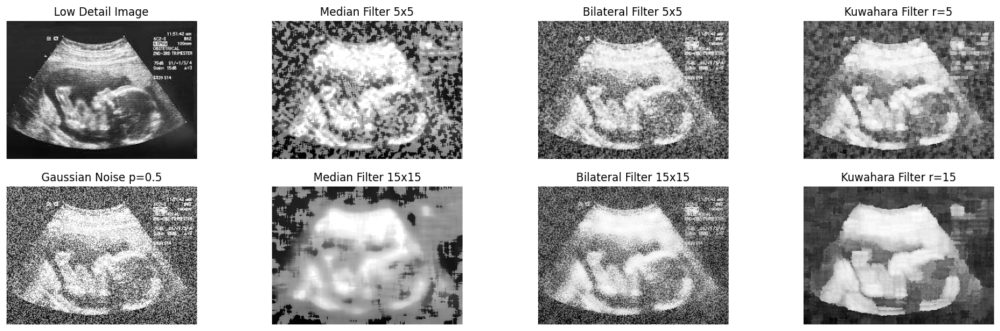

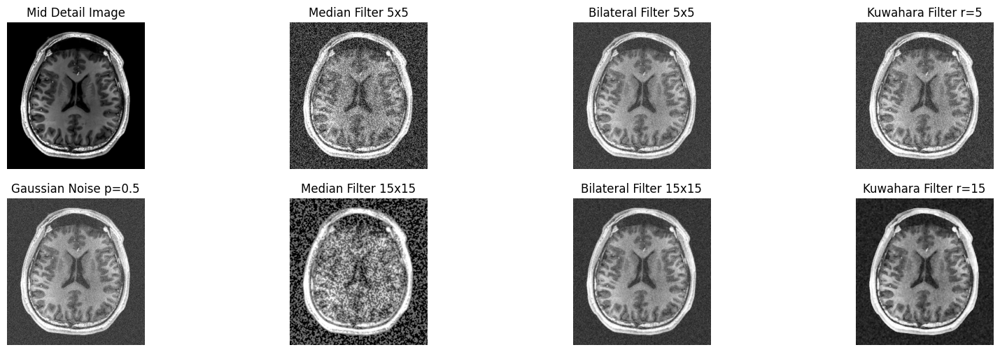

In [ ]:
execute_filters('Gaussian', 0.5, medical_test_images)

### **Probability: 0.8**


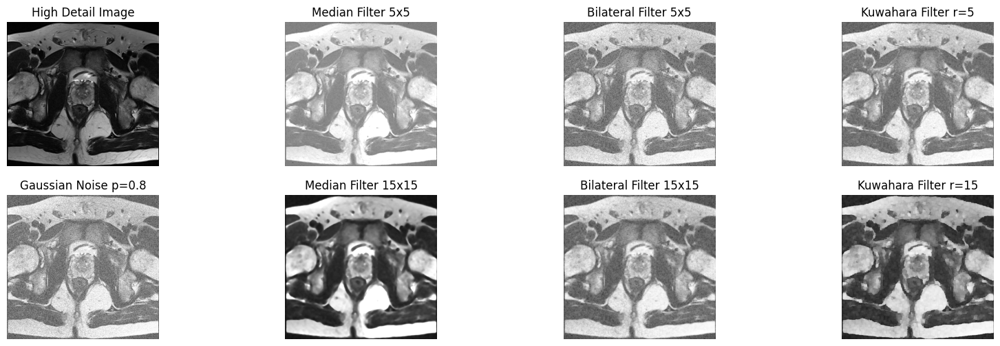

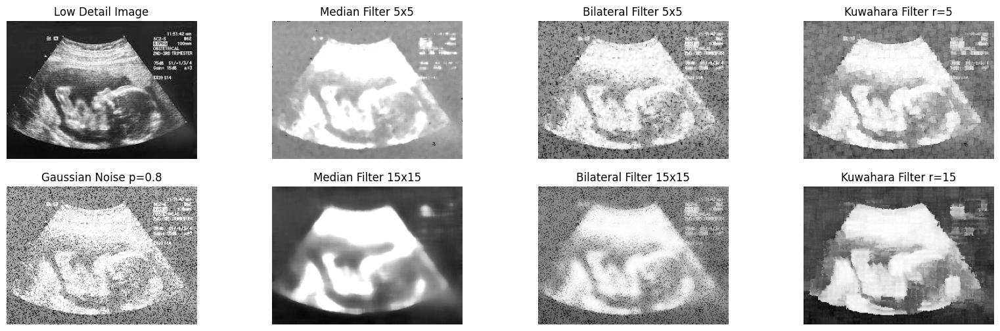

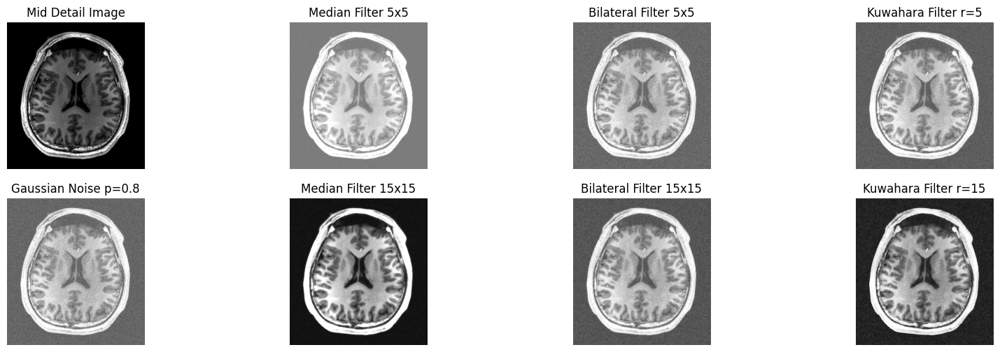

In [ ]:
execute_filters('Gaussian', 0.8, medical_test_images)

## **Uniform Noise**

### **Probability: 0.1**

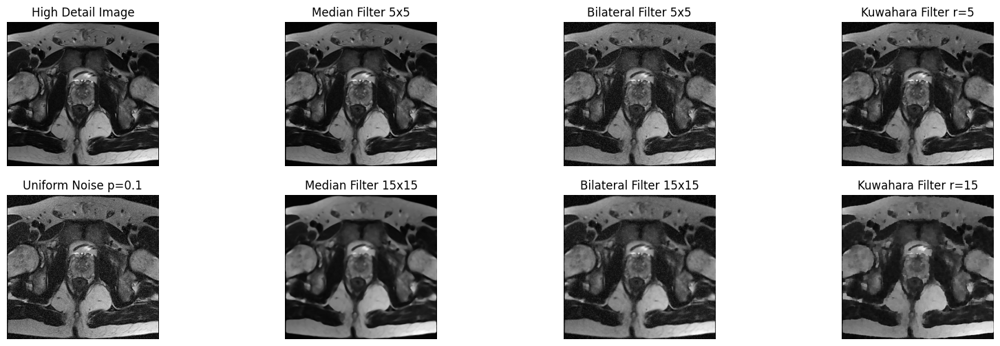

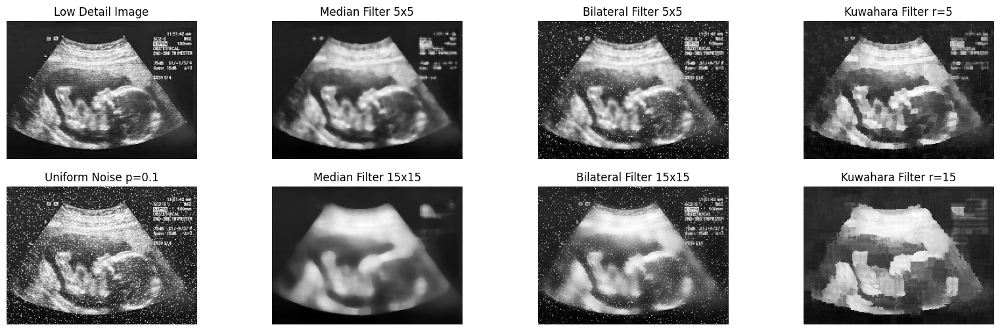

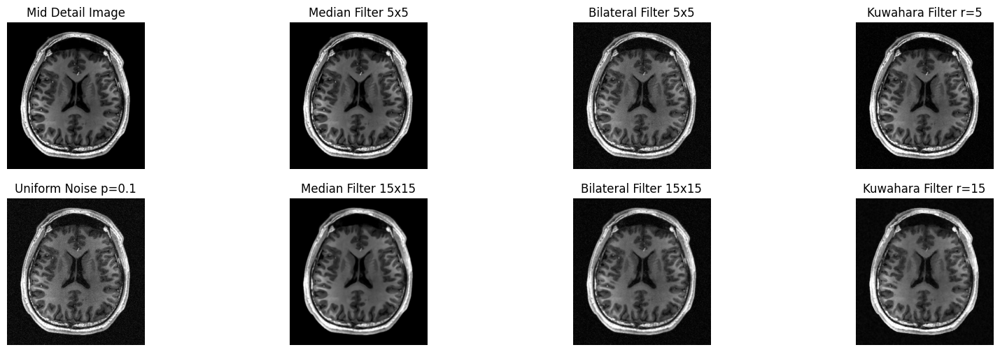

In [ ]:
execute_filters('Uniform', 0.1, medical_test_images)

### **Probability: 0.5**

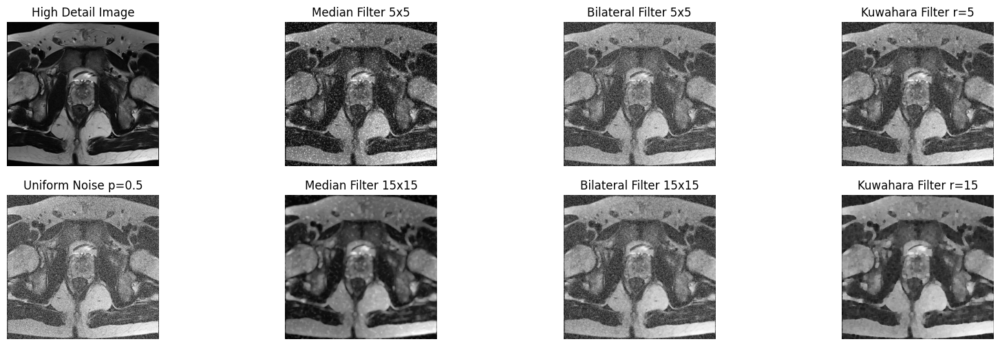

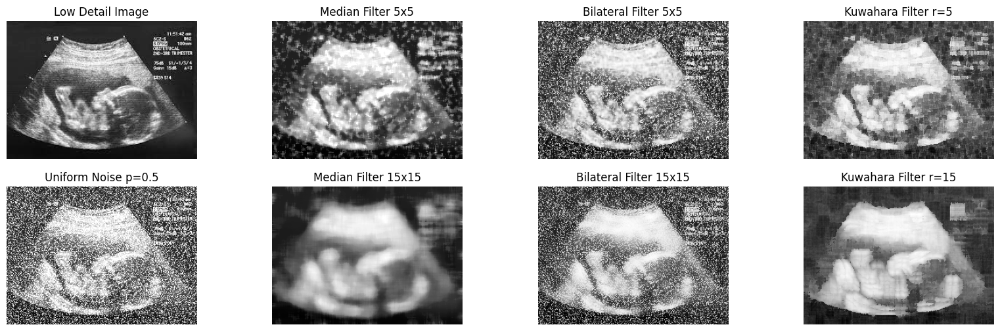

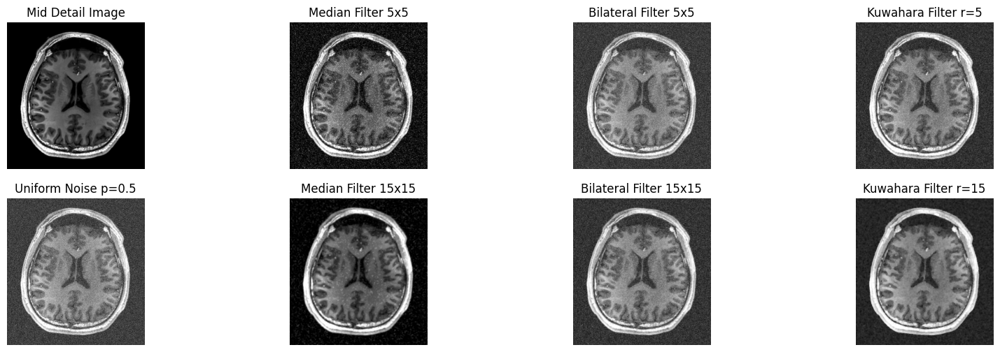

In [ ]:
execute_filters('Uniform', 0.5, medical_test_images)

### **Probability: 0.8**

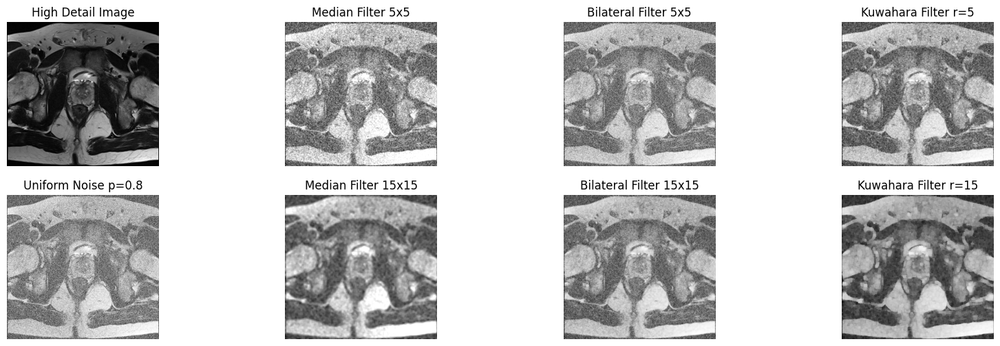

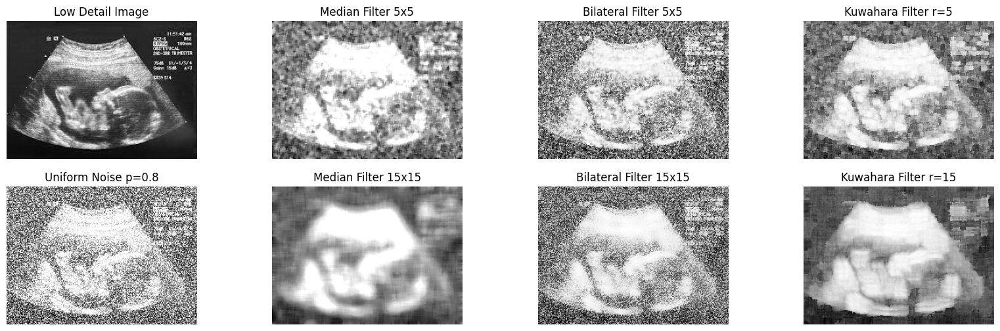

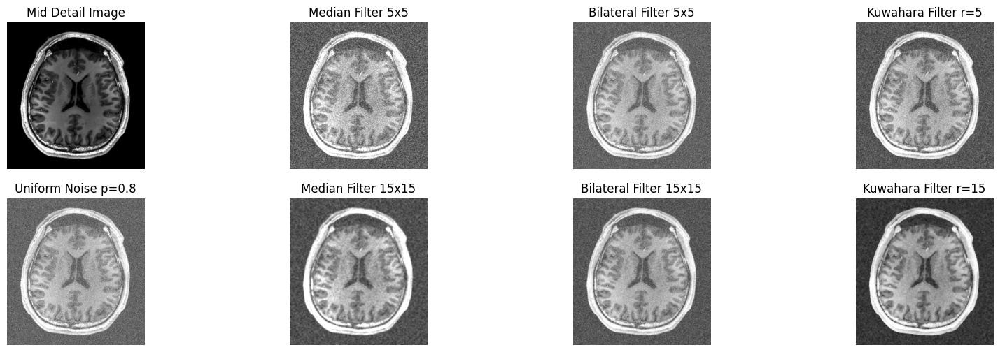

In [ ]:
execute_filters('Uniform', 0.8, medical_test_images)

# **Mahmut Tuncer Images**

In [ ]:
# Create a list to store mahmut tuncer grayscale images
mahmut_test_images = []

for file in file_list:
  if file.startswith("mt_"):
      file_path = os.path.join(folder_path, file)
      # Read the grayscale image
      image = cv2.imread(file_path, cv2.IMREAD_GRAYSCALE)
      # Append the grayscale image to the list
      mahmut_test_images.append(image)

## **Gaussian Noise**

### **Probability: 0.1**

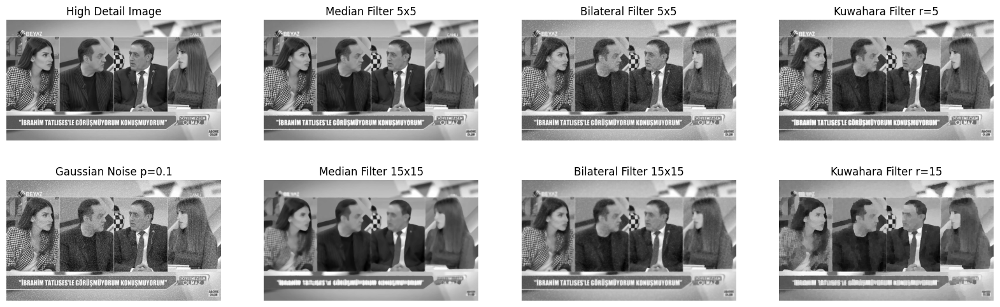

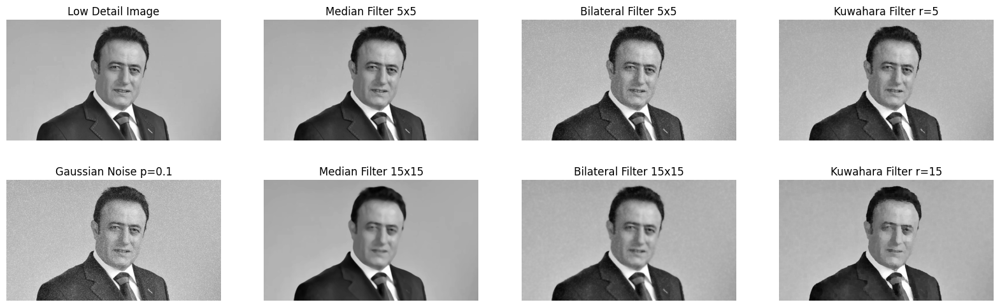

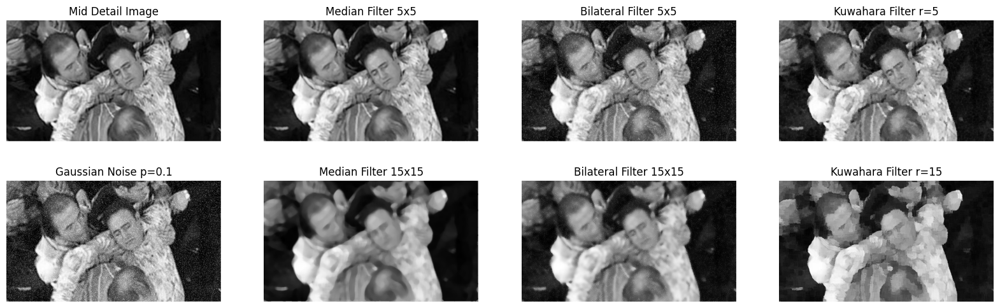

In [ ]:
execute_filters('Gaussian', 0.1, mahmut_test_images)

### **Probability: 0.5**

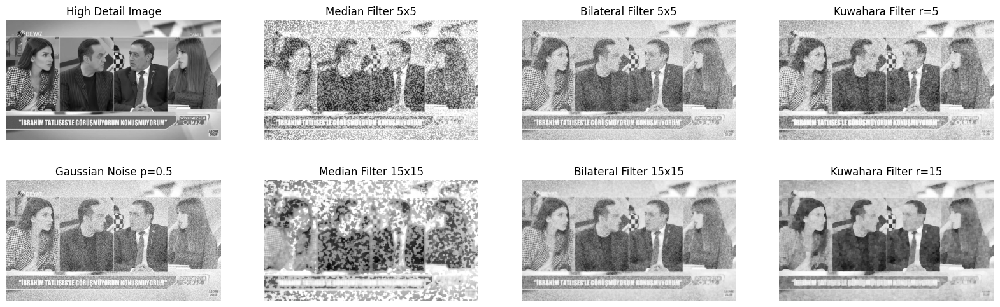

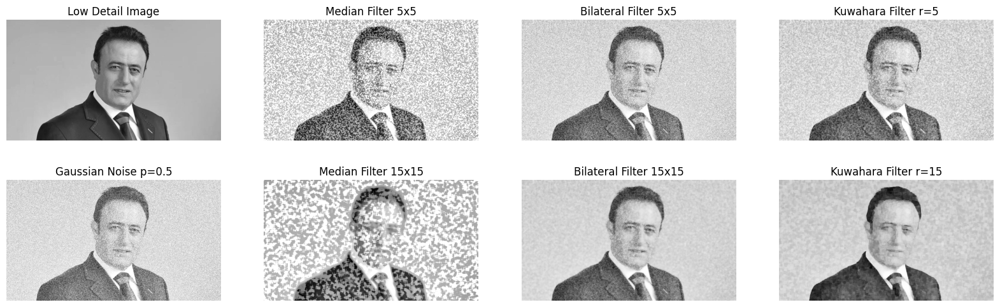

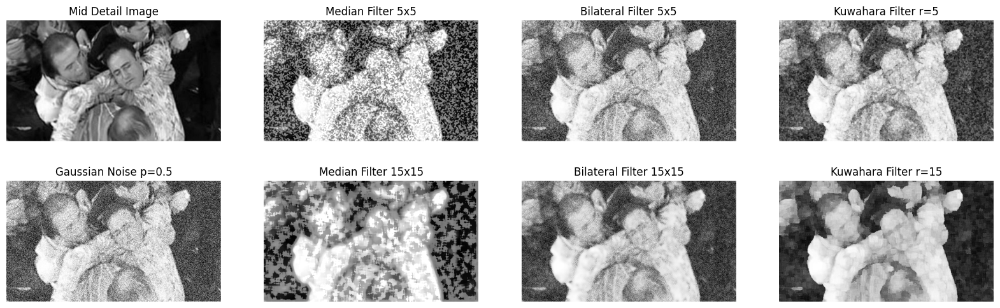

In [ ]:
execute_filters('Gaussian', 0.5, mahmut_test_images)

### **Probability: 0.8**

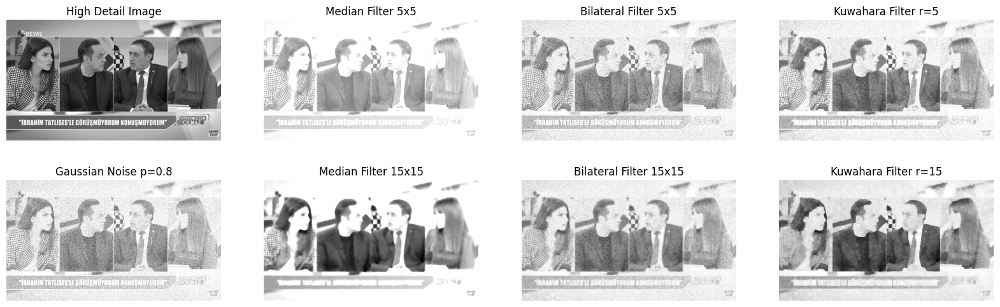

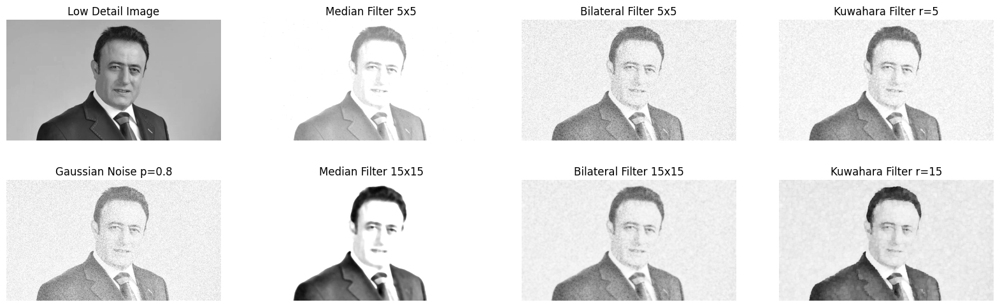

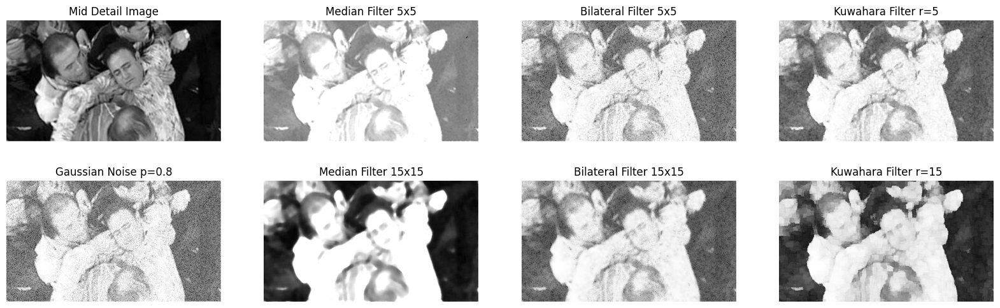

In [ ]:
execute_filters('Gaussian', 0.8, mahmut_test_images)

## **Uniform Noise**

### **Probability: 0.1**

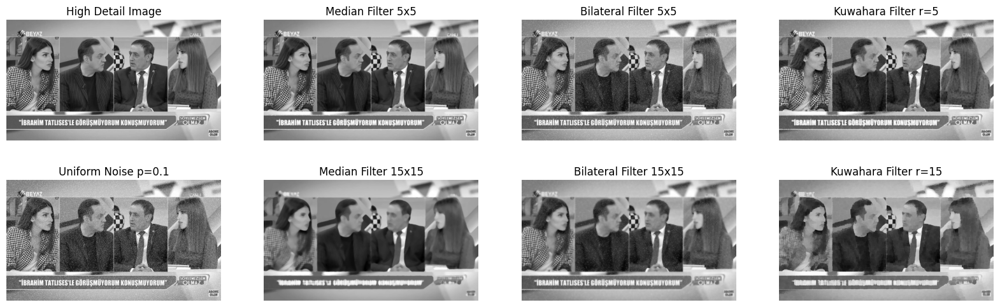

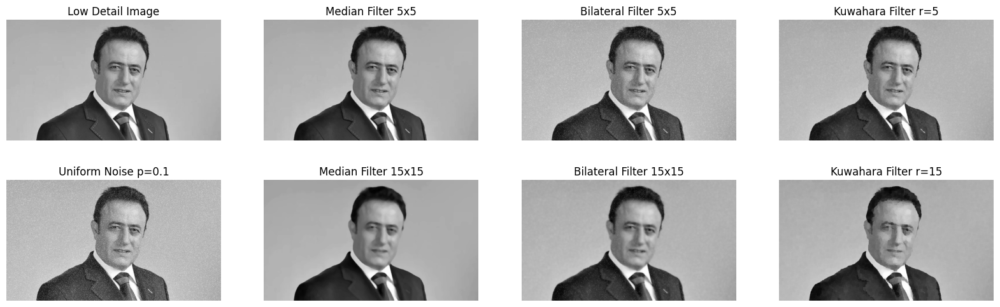

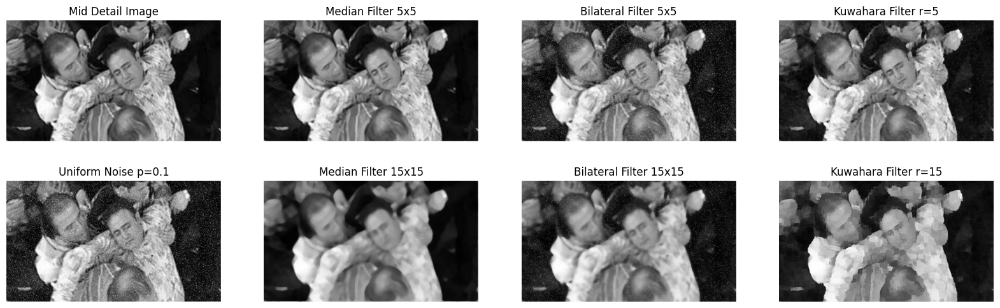

In [ ]:
execute_filters('Uniform', 0.1, mahmut_test_images)

### **Probability: 0.5**

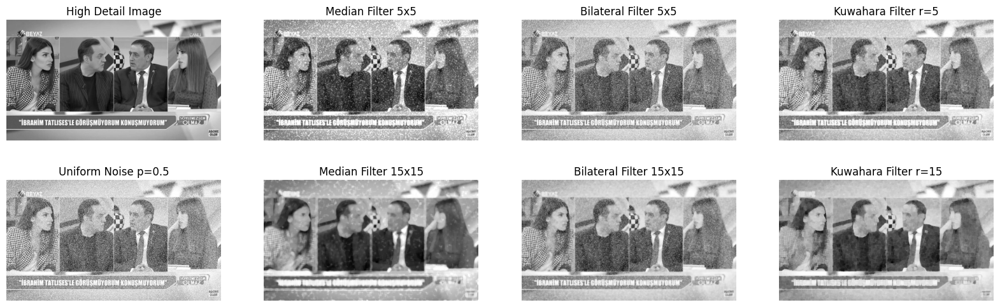

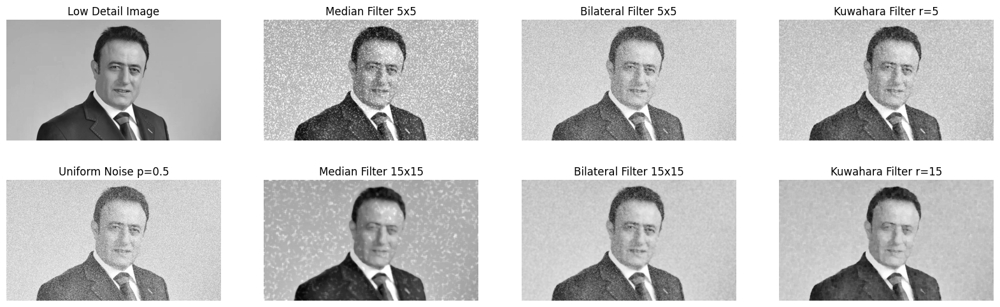

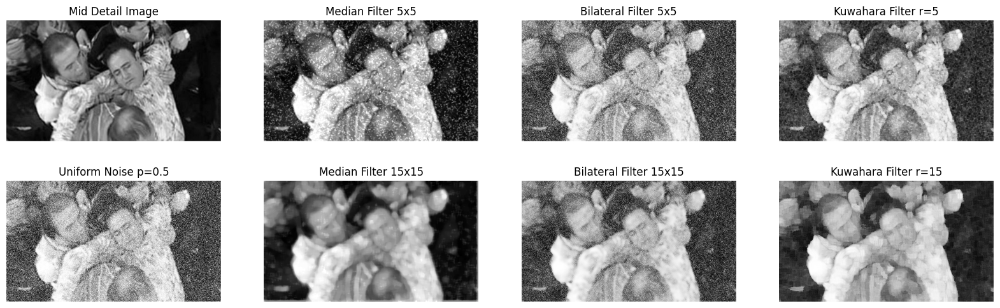

In [ ]:
execute_filters('Uniform', 0.5, mahmut_test_images)

### **Probability: 0.8**

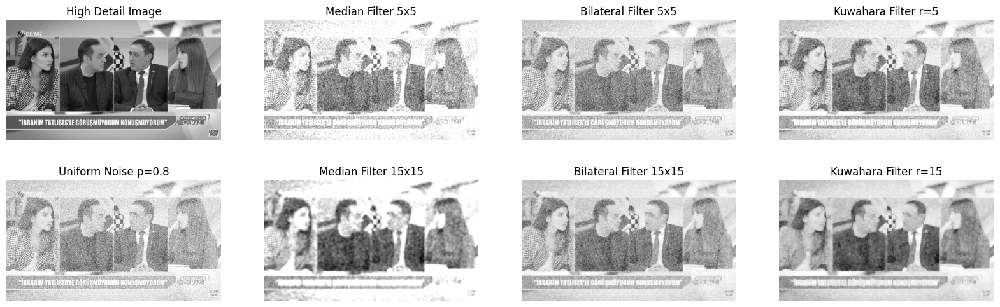

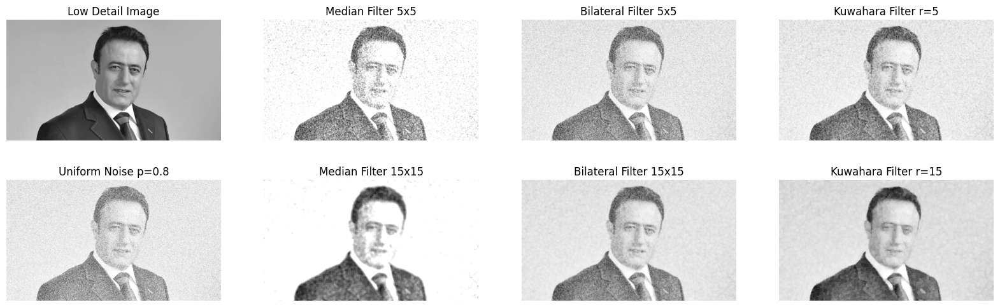

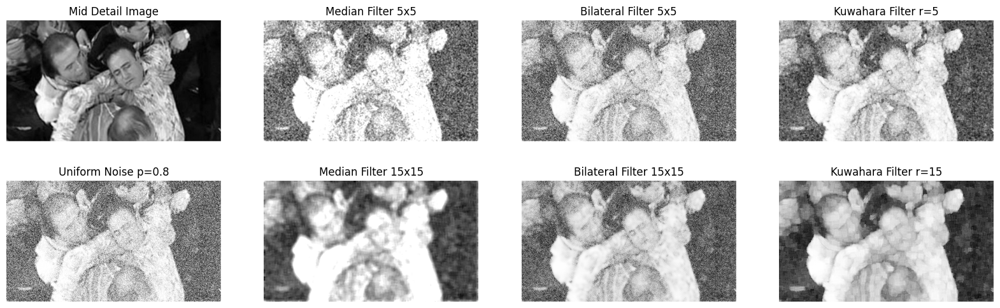

In [ ]:
execute_filters('Uniform', 0.8, mahmut_test_images)